In [1]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt

Number of images of Apple___Apple_scab: 504 || Number of images of Apple___Black_rot: 496 || Number of images of Apple___Cedar_apple_rust: 220 || Number of images of Apple___healthy: 1316 || Number of images of Blueberry___healthy: 1202 || Number of images of Cherry_(including_sour)___healthy: 684 || Number of images of Cherry_(including_sour)___Powdery_mildew: 842 || Number of images of Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot: 410 || Number of images of Corn_(maize)___Common_rust_: 953 || Number of images of Corn_(maize)___healthy: 929 || Number of images of Corn_(maize)___Northern_Leaf_Blight: 788 || Number of images of Grape___Black_rot: 944 || Number of images of Grape___Esca_(Black_Measles): 1107 || Number of images of Grape___healthy: 339 || Number of images of Grape___Leaf_blight_(Isariopsis_Leaf_Spot): 861 || Number of images of Orange___Haunglongbing_(Citrus_greening): 4405 || Number of images of Peach___Bacterial_spot: 1838 || Number of images of Peach___healthy: 2

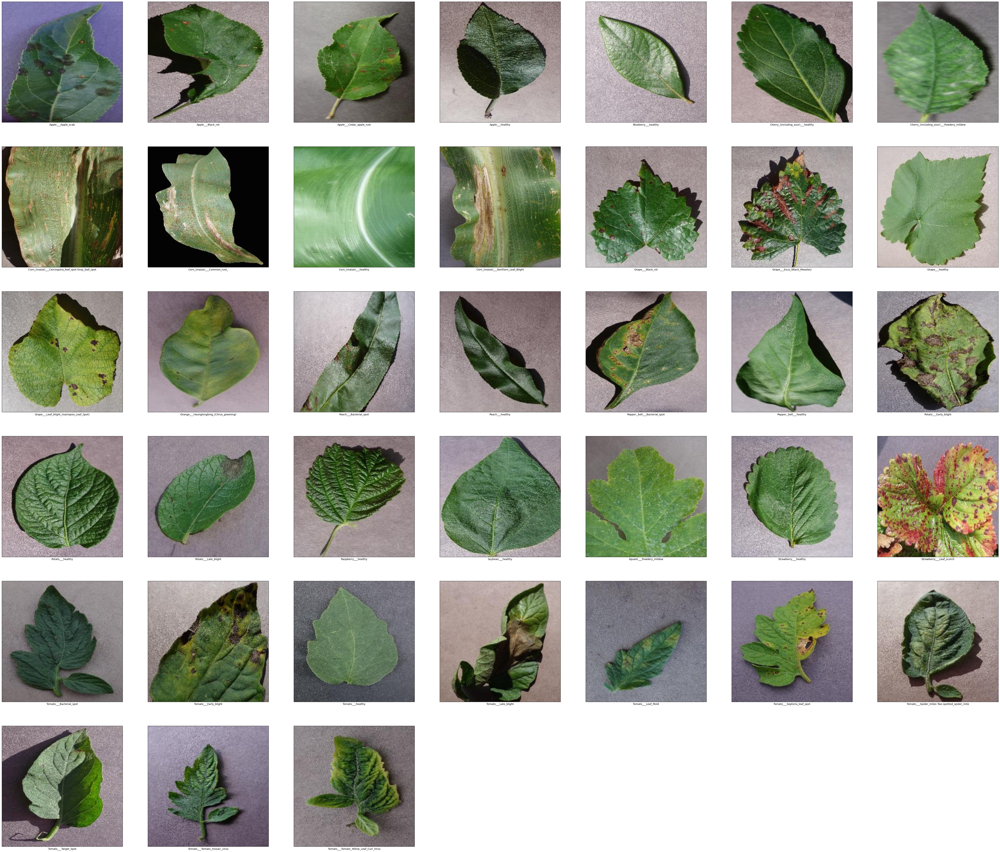

In [2]:
path= r'C:\Users\mdadn\Downloads\archive (1)\PlantVillage\train'
plt.figure(figsize=(70,70))
count=0
plant_names=[]
total_images=0
for i in os.listdir(path):
  count+=1
  plant_names.append(i)
  plt.subplot(7,7,count)

  images_path=os.listdir(path+"/"+i)
  print("Number of images of "+i+":",len(images_path),"||",end=" ")
  total_images+=len(images_path)

  image_show=plt.imread(path+"/"+i+"/"+images_path[0])
  
  plt.imshow(image_show)
  plt.xlabel(i)
  
  plt.xticks([])
  plt.yticks([])


print("Total number of images we have",total_images)

In [3]:
print(plant_names)
print(len(plant_names))

['Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy', 'Blueberry___healthy', 'Cherry_(including_sour)___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot', 'Corn_(maize)___Common_rust_', 'Corn_(maize)___healthy', 'Corn_(maize)___Northern_Leaf_Blight', 'Grape___Black_rot', 'Grape___Esca_(Black_Measles)', 'Grape___healthy', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Orange___Haunglongbing_(Citrus_greening)', 'Peach___Bacterial_spot', 'Peach___healthy', 'Pepper,_bell___Bacterial_spot', 'Pepper,_bell___healthy', 'Potato___Early_blight', 'Potato___healthy', 'Potato___Late_blight', 'Raspberry___healthy', 'Soybean___healthy', 'Squash___Powdery_mildew', 'Strawberry___healthy', 'Strawberry___Leaf_scorch', 'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___healthy', 'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite',

In [4]:
import tensorflow
from tensorflow import keras
from keras.models import Sequential,load_model,Model
from keras.layers import Conv2D,MaxPool2D,AveragePooling2D,Dense,Flatten,ZeroPadding2D,BatchNormalization,Activation,Add,Input,Dropout,GlobalAveragePooling2D
from keras.optimizers import SGD
from keras.initializers import glorot_uniform
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ModelCheckpoint,EarlyStopping,ReduceLROnPlateau

In [5]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input

In [6]:
base_model_tf=ResNet50(include_top=False,weights='imagenet',input_shape=(224,224,3),classes=38)

In [7]:
base_model_tf.trainable = False

# Define the input layer
pt = Input(shape=(224, 224, 3))

# Preprocessing: This will zero-center each color channel with respect to the ImageNet dataset
x = preprocess_input(pt)

# Pass the input through the base model (ResNet50)
x = base_model_tf(x, training=False)

# Apply Global Average Pooling to reduce the spatial dimensions
x = GlobalAveragePooling2D()(x)

# Add fully connected layers
x = Dense(128, activation='relu')(x)
x = Dense(64, activation='relu')(x)

# Output layer with softmax activation (for classification with 38 classes)
x = Dense(38, activation='softmax')(x)

# Create the final model
model_main = Model(inputs=pt, outputs=x)

# Print the model summary
model_main.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item (GetItem)  │ (None, 224, 224)  │          0 │ input_layer_1[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_1          │ (None, 224, 224)  │          0 │ input_layer_1[0]… │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_2          │ (None, 224, 224)  │          0 │ input_layer_1[0]… │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stack (Stack)       │ (None, 224, 224,  │          0 │ get_item[0][0],   │
│                     │ 3)                │            │ get_item_1[0][0], │
│                     │                   │            │ get_item_2[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 224, 224,  │          0 │ stack[0][0]       │
│                     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ resnet50            │ (None, 7, 7,      │ 23,587,712 │ add[0][0]         │
│ (Functional)        │ 2048)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_average_poo… │ (None, 2048)      │          0 │ resnet50[0][0]    │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, 128)       │    262,272 │ global_average_p… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_1 (Dense)     │ (None, 64)        │      8,256 │ dense[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_2 (Dense)     │ (None, 38)        │      2,470 │ dense_1[0][0]     │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 23,860,710 (91.02 MB)

 Trainable params: 272,998 (1.04 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [8]:
#Image augmentation
train_datagen= ImageDataGenerator(shear_range=0.2,zoom_range=0.2,horizontal_flip=False,vertical_flip=False
                                  ,fill_mode='nearest',width_shift_range=0.2,height_shift_range=0.2)

val_datagen=ImageDataGenerator()

path_train= r'C:\Users\mdadn\Downloads\archive (1)\PlantVillage\train'

path_valid= r'C:\Users\mdadn\Downloads\archive (1)\PlantVillage\val'

train= train_datagen.flow_from_directory(directory=path_train,batch_size=32,target_size=(224,224),
                                         color_mode='rgb',class_mode='categorical',seed=42)

valid=val_datagen.flow_from_directory(directory=path_valid,batch_size=32,target_size=(224,224),color_mode='rgb',class_mode='categorical')

Found 43444 images belonging to 38 classes.
Found 10861 images belonging to 38 classes.


In [9]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau

# EarlyStopping: stops training when the validation accuracy stops improving
es = EarlyStopping(monitor='val_accuracy', verbose=1, patience=7, mode='auto')

# ModelCheckpoint: saves the best model based on validation accuracy
# Use a valid file path with '.keras' extension for local environments
mc = ModelCheckpoint(filepath='./best_model.keras', monitor='val_accuracy', verbose=1, save_best_only=True)

# ReduceLROnPlateau: reduces the learning rate when validation accuracy stops improving
lr = ReduceLROnPlateau(monitor='val_accuracy', verbose=1, patience=5, min_lr=0.001)


In [10]:
model_main.compile(optimizer='Adam',loss='categorical_crossentropy',metrics=['accuracy'])

In [12]:
model_main.fit(train,validation_data=valid,epochs=30,steps_per_epoch=200,verbose=1,callbacks=[mc,es,lr])

Epoch 1/30
200/200 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.7199 - loss: 1.0463

c:\Users\mdadn\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()



Epoch 1: val_accuracy improved from -inf to 0.85535, saving model to ./best_model.keras
200/200 ━━━━━━━━━━━━━━━━━━━━ 727s 4s/step - accuracy: 0.7202 - loss: 1.0449 - val_accuracy: 0.8554 - val_loss: 0.5132 - learning_rate: 0.0010
Epoch 2/30
200/200 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.8773 - loss: 0.4086
Epoch 2: val_accuracy improved from 0.85535 to 0.91272, saving model to ./best_model.keras
200/200 ━━━━━━━━━━━━━━━━━━━━ 719s 4s/step - accuracy: 0.8773 - loss: 0.4085 - val_accuracy: 0.9127 - val_loss: 0.2833 - learning_rate: 0.0010
Epoch 3/30
200/200 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.9132 - loss: 0.2699
Epoch 3: val_accuracy did not improve from 0.91272
200/200 ━━━━━━━━━━━━━━━━━━━━ 718s 4s/step - accuracy: 0.9132 - loss: 0.2698 - val_accuracy: 0.9020 - val_loss: 0.2922 - learning_rate: 0.0010
Epoch 4/30
200/200 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.9289 - loss: 0.2289
Epoch 4: val_accuracy improved from 0.91272 to 0.93435, saving model to ./best_model.ker

c:\Users\mdadn\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\trainers\epoch_iterator.py:107: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()



Epoch 7: val_accuracy improved from 0.94503 to 0.95129, saving model to ./best_model.keras
200/200 ━━━━━━━━━━━━━━━━━━━━ 661s 3s/step - accuracy: 0.9571 - loss: 0.1476 - val_accuracy: 0.9513 - val_loss: 0.1538 - learning_rate: 0.0010
Epoch 8/30
200/200 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.9446 - loss: 0.1760
Epoch 8: val_accuracy did not improve from 0.95129
200/200 ━━━━━━━━━━━━━━━━━━━━ 723s 4s/step - accuracy: 0.9446 - loss: 0.1760 - val_accuracy: 0.9292 - val_loss: 0.2184 - learning_rate: 0.0010
Epoch 9/30
200/200 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.9480 - loss: 0.1655
Epoch 9: val_accuracy did not improve from 0.95129
200/200 ━━━━━━━━━━━━━━━━━━━━ 720s 4s/step - accuracy: 0.9480 - loss: 0.1654 - val_accuracy: 0.9307 - val_loss: 0.2123 - learning_rate: 0.0010
Epoch 10/30
200/200 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.9440 - loss: 0.1703
Epoch 10: val_accuracy did not improve from 0.95129
200/200 ━━━━━━━━━━━━━━━━━━━━ 719s 4s/step - accuracy: 0.9440 - loss: 0.1

In [13]:
model_main.save("final.keras")